<a href="https://colab.research.google.com/github/EveTLynn/Blood-Cells-Detection/blob/main/Blood_Cells_Detection_with_RetinaResnet_(TFM).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Blood Cells Detection with RetinaResnet (TFM)

This notebook fine-tunes a [RetinaNet](https://arxiv.org/abs/1708.02002) with ResNet-50 as backbone model from the [TensorFlow Model Garden](https://pypi.org/project/tf-models-official/) package to detect three different Blood Cells in [BCCD](https://github.com/Shenggan/BCCD_Dataset) dataset.

This notebook includes the following steps:

1. Preapare the dataset for object detection, includes:
  - Augment images and annotations to increase data
  - Convert the dataset to TFRecord format
2. Configure the model from the Tensorflow Model Garden (TFM) package
3. Train and evaluate and export trained model
4. Infer on test set

# 0 - Import required libraries

In [ ]:
!pip install -U -q "tf-models-official"

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.7/2.7 MB 827.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 106.6/106.6 kB 776.6 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 791.1 kB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 242.5/242.5 kB 858.9 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 539.1 kB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 589.8/589.8 MB 1.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 4.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 2.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 3.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 3.1 MB/s eta 0:0

In [ ]:
import os
import random
import shutil
import io
import pprint
import tempfile
import matplotlib
import numpy as np
import tensorflow as tf
import matplotlib.pyplot as plt
import pandas as pd
import glob

from PIL import Image
from six import BytesIO
from IPython import display
from urllib.request import urlopen
import cv2
import xml.etree.ElementTree as ET
import albumentations as alb

In [ ]:
# Import required libraries from tensorflow models
import orbit
import tensorflow_models as tfm

from official.core import exp_factory
from official.core import config_definitions as cfg
from official.vision.serving import export_saved_model_lib
from official.vision.ops.preprocess_ops import normalize_image
from official.vision.ops.preprocess_ops import resize_and_crop_image
from official.vision.utils.object_detection import visualization_utils
from official.vision.dataloaders.tf_example_decoder import TfExampleDecoder

pp = pprint.PrettyPrinter(indent=4) # Set Pretty Print Indentation
print(tf.__version__) # Check the version of tensorflow used

%matplotlib inline

2.16.1


# 1 - Custom dataset preparation for object detection

Models in official repository (of model-garden) requires data in a TFRecords format.Please check [this resource](https://www.tensorflow.org/tutorials/load_data/tfrecord) to learn more about TFRecords data format.

This sections includes the following steps:
1. Clone the [BCCD dataset](https://github.com/Shenggan/BCCD_Dataset) and my github repo for custom_preprocessing, voc2coco, and labels scripts
2. Define paths, create folders and split images, annotations to 3 folders: train, val, test
3. Data augmentation with Albumentations library
4. Convert annotations from PASCAL VOC format to COCO format
5. Generate TFRecords


## 1.1 - Cloning data and scripts

In [ ]:
# clone BCCD Dataset github repo
!git clone https://github.com/Shenggan/BCCD_Dataset

Cloning into 'BCCD_Dataset'...
remote: Enumerating objects: 800, done.
remote: Total 800 (delta 0), reused 0 (delta 0), pack-reused 800
Receiving objects: 100% (800/800), 7.39 MiB | 22.85 MiB/s, done.
Resolving deltas: 100% (378/378), done.


In [ ]:
# clone my github repo for the scripts
!git clone https://github.com/EveTLynn/Blood-Cells-Detection

Cloning into 'Blood-Cells-Detection'...
remote: Enumerating objects: 1018, done.
remote: Counting objects: 100% (28/28), done.
remote: Compressing objects: 100% (28/28), done.
remote: Total 1018 (delta 8), reused 0 (delta 0), pack-reused 990
Receiving objects: 100% (1018/1018), 49.35 MiB | 14.63 MiB/s, done.
Resolving deltas: 100% (468/468), done.


In [ ]:
# import custom preprocessing functions
import sys
sys.path.append('/content/Blood-Cells-Detection/scripts')
from custom_preprocess import split_images, create_filenamelist_and_move_annotations, augment_images, create_image_df, write_xml_annotation

## 1.2 - Divide images and annotations into train, test and validation folders

In [ ]:
### define paths and create folders for train, val, test ###
images_path = '/content/BCCD_Dataset/BCCD/JPEGImages'
annotation_path = '/content/BCCD_Dataset/BCCD/Annotations'
my_github_path ='/content/Blood-Cells-Detection'

# path to new images folders
train_images_folder = os.path.join(my_github_path, 'bccd_dataset', 'train', 'images')
val_images_folder = os.path.join(my_github_path, 'bccd_dataset', 'val', 'images')
test_images_folder = os.path.join(my_github_path, 'bccd_dataset', 'test', 'images')
# path to new annotation folders
train_anno_folder = os.path.join(my_github_path, 'bccd_dataset', 'train', 'annotations')
val_anno_folder = os.path.join(my_github_path, 'bccd_dataset', 'val', 'annotations')
test_anno_folder = os.path.join(my_github_path, 'bccd_dataset', 'test', 'annotations')

# Create destination folders if they don't exist
for folder_path in [train_images_folder, val_images_folder, test_images_folder,
                    train_anno_folder, val_anno_folder, test_anno_folder]:
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)

In [ ]:
#Spilt images into train, val, test (ratio = 0.85, 0.1, 0.05)
split_images(images_path, train_images_folder, val_images_folder, test_images_folder)

# create train, val, test txt files and move annotations
create_filenamelist_and_move_annotations(train_images_folder, 'train.txt', annotation_path, train_anno_folder)
create_filenamelist_and_move_annotations(val_images_folder, 'val.txt', annotation_path, val_anno_folder)
create_filenamelist_and_move_annotations(test_images_folder, 'test.txt', annotation_path, test_anno_folder)

# move txt files (these can be use for voc2coco & tfrecords generation if you don't want augmenting data)
!mv train.txt /content/Blood-Cells-Detection/bccd_dataset/train
!mv val.txt /content/Blood-Cells-Detection/bccd_dataset/val
!mv test.txt /content/Blood-Cells-Detection/bccd_dataset/test

Number of images: 364
Train set: 309, Val set: 36, Test set: 18


## 1.3 - Data Augmentation
This will utilize the custom function written in custom_preprocess.py script which invovles these steps:
1. Parse xml annotations for coordinates of boundings boxes with corresponding labels
2. Augment images and bounding boxes
3. Save augmented images and writes new xml annotations

The Augmentation have some default parameters: random crop to 256 x 256 (height x width), drop bboxes with less than 50% visibility, 3 augmented images per each original one, random flip (vertical and horizontal), random brigtness, rgbshift and gamma.

In [ ]:
# define input_path
input_train_path = os.path.join(my_github_path, 'bccd_dataset', 'train')
input_val_path = os.path.join(my_github_path, 'bccd_dataset', 'val')
input_test_path= os.path.join(my_github_path, 'bccd_dataset', 'test')

# define output paths
aug_train_path = os.path.join(my_github_path,'augmented_data', 'train')
aug_val_path = os.path.join(my_github_path,'augmented_data', 'val')
aug_test_path = os.path.join(my_github_path,'augmented_data', 'test')

# Create output folders if they don't exist
for folder_path in [aug_train_path, aug_val_path, aug_test_path]:
    if not os.path.exists(folder_path):
        os.makedirs(folder_path)

In [ ]:
# use the custom augmnetation function from custom_preprocess.py script
num_aug = 10  # don't augment more than 10 images
augment_images(input_path=input_train_path, output_path=aug_train_path, num_augmentations=num_aug)
augment_images(input_path=input_val_path, output_path=aug_val_path, num_augmentations=num_aug)
augment_images(input_path=input_test_path, output_path=aug_test_path, num_augmentations=num_aug)

Skipping invalid bbox: [181, 329, 181, 329] for image: BloodImage_00343.jpg.
Skipping invalid bbox: [504, 337, 504, 337] for image: BloodImage_00338.jpg.


**Some note on augmentation**

The `custom_preprocess.py` script may cause some problem if augmenting >10 images for each original images, for ex:

- Image 5 -> 50,51,..., **510**
- Image 51 -> **510**,...

We'll have overlapping image_id. However, because the `voc2coco.py` will split the filename by any delimiter and use the first part to get the image ids, adding any delimiers to distinguish the augmented images would be tricky. So for the current `custom_preprocess.py` script. Don't generate > 10 augmneted images per original image.

### Check if the augmentation worked


Random image name: BloodImage_002698
Image shape: (256, 256, 3)


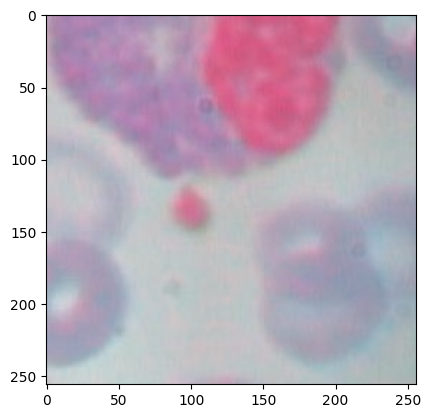

In [ ]:
# Randomly visualize one image to see if the augmnetation applied successfully
def get_random_name(filename):
  """Reads a file containing names and returns a random name."""
  with open(filename, 'r') as file:
    names = file.readlines()
  return random.choice(names).strip()

working_path = '/content/Blood-Cells-Detection/augmented_data'
file_path = os.path.join(working_path, 'train', 'filenames.txt')
random_name = get_random_name(file_path)
print(f"Random image name: {random_name}")

image_path = os.path.join(working_path, 'train', 'images', f"{random_name}.jpg")
anno_path = os.path.join(working_path, 'train', 'annotations', f"{random_name}.xml")
image = cv2.imread(image_path)
print(f"Image shape: {image.shape}")
plt.imshow(image)

In [ ]:
# parse the xml file to dataframe
tree = ET.parse(anno_path)
root = tree.getroot()
xml_list = []

for member in root.findall('object'):
  # Extract filename, width, height, class name, and bounding box coordinates
  value = (
      root.find('filename').text,
      int(root.find('size')[0].text),  # Image width
      int(root.find('size')[1].text),  # Image height
      member[0].text,                  # Object class
      int(member[2][0].text),  # xmin
      int(member[2][1].text),  # ymin
      int(member[2][2].text),  # xmax
      int(member[2][3].text)   # ymax
  )
  xml_list.append(value)

column_names = ['filename', 'width', 'height', 'class', 'xmin', 'ymin', 'xmax', 'ymax']
xml_df = pd.DataFrame(xml_list, columns=column_names)
xml_df

,filename,width,height,class,xmin,ymin,xmax,ymax
0,BloodImage_002698.jpg,256,256,RBC,0,149,61,250
1,BloodImage_002698.jpg,256,256,RBC,142,159,241,248
2,BloodImage_002698.jpg,256,256,RBC,0,72,59,162
3,BloodImage_002698.jpg,256,256,Platelets,81,114,127,153
4,BloodImage_002698.jpg,256,256,WBC,0,0,244,120


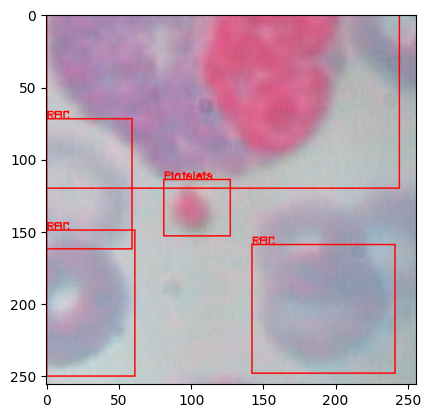

In [ ]:
# visualize the image
for i in range(len(xml_df)):
  cv2.rectangle(image,
                xml_df.iloc[i, 4:6].values.astype(int), # get xmin, ymin
                xml_df.iloc[i, 6:].values.astype(int),  # get xmax, ymax
                (255,0,0),                              # color of bbox
                1)

  cv2.putText(image,
              xml_df['class'][i],
              xml_df.iloc[i, 4:6].values.astype(int),
              cv2.FONT_HERSHEY_SIMPLEX,
              1e-3 * image.shape[0],                  # font scale factor (* with the base size)
              (255,0,0),                              # color of text string
              1)

plt.imshow(image)

The augmentation does seem to be working properly!!

## 1.4 - Convert the annotions from PASCAL VOC to Coco format
Since RetinaNet object detection is based on [COCO](https://cocodataset.org/) format, we need to convert the annotations from PASCAL VOC format to Coco format using the voc2coco script from [roboflow github](https://github.com/roboflow/voc2coco)  . This will require:
1. Annotations directory path
2. txt file of annotation filenames (without the extension)
3. A label txt file if you want to turn the labels to ids in number
4. output file path

In [ ]:
cd Blood-Cells-Detection/

/content/Blood-Cells-Detection


In [ ]:
%%bash

python scripts/voc2coco.py \
  --ann_dir augmented_data/train/annotations \
  --ann_ids augmented_data/train/filenames.txt \
  --labels scripts/labels.txt \
  --output augmented_data/train/train_cocoformat.json \
  --ext xml

Start converting !


100%|██████████| 3090/3090 [00:00<00:00, 4530.79it/s]


In [ ]:
%%bash

python scripts/voc2coco.py \
  --ann_dir augmented_data/val/annotations \
  --ann_ids augmented_data/val/filenames.txt \
  --labels scripts/labels.txt \
  --output augmented_data/val/val_cocoformat.json \
  --ext xml

Start converting !


100%|██████████| 360/360 [00:00<00:00, 5945.69it/s]


In [ ]:
%%bash

python scripts/voc2coco.py \
  --ann_dir augmented_data/test/annotations \
  --ann_ids augmented_data/test/filenames.txt \
  --labels scripts/labels.txt \
  --output augmented_data/test/test_cocoformat.json \
  --ext xml

Start converting !


100%|██████████| 190/190 [00:00<00:00, 15709.00it/s]


## 1.5 - Generating TF Records
Using CLI command for train, validation and test data

In [ ]:
cd augmented_data

/content/Blood-Cells-Detection/augmented_data


In [ ]:
%%bash

TRAIN_DATA_DIR='./train/images'
TRAIN_ANNOTATION_FILE_DIR='./train/train_cocoformat.json'
OUTPUT_TFRECORD_TRAIN='./bccd_coco_tfrecords/train'

# Need to provide
  # 1. image_dir: where images are present
  # 2. object_annotations_file: where annotations are listed in json format
  # 3. output_file_prefix: where to write output convered TFRecords files
python -m official.vision.data.create_coco_tf_record --logtostderr \
  --image_dir=${TRAIN_DATA_DIR} \
  --object_annotations_file=${TRAIN_ANNOTATION_FILE_DIR} \
  --output_file_prefix=${OUTPUT_TFRECORD_TRAIN} \
  --num_shards=1

2024-03-19 02:40:20.146569: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
I0319 02:40:23.321534 138415007760384 create_coco_tf_record.py:502] writing to output path: ./bccd_coco_tfrecords/train
I0319 02:40:23.388615 138415007760384 create_coco_tf_record.py:374] Building bounding box index.
I0319 02:40:23.391240 138415007760384 create_coco_tf_record.py:385] 99 images are missing bboxes.
I0319 02:40:25.693510 138415007760384 tfrecord_lib.py:168] On image 0
I0319 02:40:25.701175 138415007760384 tfrecord_lib.py:168] On image 100
I0319 02:40:25.708642 138415007760384 tfrecord_lib.py:168] On image 200
I0319 02:40:25.718951 138415007760384 tfrecord_lib.py:168] On image 300
I0319 02:40:25.724659 138415007760384 tfrecord_lib.py:168] On image 400
I0319 02:40:25.731668 138415007760384 tfrecord_lib.py:168] On image 500
I0319 02:40:25.738899 138415007760384 tfrecord_lib.py:168] On image 600
I0319 02:40:25.746302 138415007760384 tfrecord_lib.py:168] 

In [ ]:
%%bash

VALID_DATA_DIR='./val/images'
VALID_ANNOTATION_FILE_DIR='./val/val_cocoformat.json'
OUTPUT_TFRECORD_VALID='./bccd_coco_tfrecords/valid'

python -m official.vision.data.create_coco_tf_record --logtostderr \
  --image_dir=$VALID_DATA_DIR \
  --object_annotations_file=$VALID_ANNOTATION_FILE_DIR \
  --output_file_prefix=$OUTPUT_TFRECORD_VALID \
  --num_shards=1

2024-03-19 02:40:29.419341: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
I0319 02:40:32.008741 132247121293312 create_coco_tf_record.py:502] writing to output path: ./bccd_coco_tfrecords/valid
I0319 02:40:32.016098 132247121293312 create_coco_tf_record.py:374] Building bounding box index.
I0319 02:40:32.016509 132247121293312 create_coco_tf_record.py:385] 5 images are missing bboxes.
I0319 02:40:32.175011 132247121293312 tfrecord_lib.py:168] On image 0
I0319 02:40:32.179863 132247121293312 tfrecord_lib.py:168] On image 100
I0319 02:40:32.184302 132247121293312 tfrecord_lib.py:168] On image 200
I0319 02:40:32.188936 132247121293312 tfrecord_lib.py:168] On image 300
I0319 02:40:32.206493 132247121293312 tfrecord_lib.py:180] Finished writing, skipped 0 annotations.
I0319 02:40:32.208947 132247121293312 create_coco_tf_record.py:537] Finished writing, skipped 0 annotations.


In [ ]:
%%bash

TEST_DATA_DIR='./test/images'
TEST_ANNOTATION_FILE_DIR='./test/test_cocoformat.json'
OUTPUT_TFRECORD_TEST='./bccd_coco_tfrecords/test'

python -m official.vision.data.create_coco_tf_record --logtostderr \
  --image_dir=$TEST_DATA_DIR \
  --object_annotations_file=$TEST_ANNOTATION_FILE_DIR \
  --output_file_prefix=$OUTPUT_TFRECORD_TEST \
  --num_shards=1

2024-03-19 02:40:34.526978: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
I0319 02:40:37.171716 137952001253376 create_coco_tf_record.py:502] writing to output path: ./bccd_coco_tfrecords/test
I0319 02:40:37.178126 137952001253376 create_coco_tf_record.py:374] Building bounding box index.
I0319 02:40:37.178509 137952001253376 create_coco_tf_record.py:385] 16 images are missing bboxes.
I0319 02:40:37.343445 137952001253376 tfrecord_lib.py:168] On image 0
I0319 02:40:37.351203 137952001253376 tfrecord_lib.py:168] On image 100
I0319 02:40:37.382709 137952001253376 tfrecord_lib.py:180] Finished writing, skipped 0 annotations.
I0319 02:40:37.384748 137952001253376 create_coco_tf_record.py:537] Finished writing, skipped 0 annotations.


# 2 - Configure the model for custom dataset.

In Model Garden, the collections of parameters that define a model are called *configs*. Model Garden can create a config based on a known set of parameters via a factory. I use the `retinanet_resnetfpn_coco` experiment configuration, as defined by `tfm.vision.configs.retinanet.retinanet_resnetfpn_coco`.

The configuration defines an experiment to train a RetinanNet with Resnet-50 as backbone, FPN as decoder.

In [ ]:
# Define model name and paths
%cd /content/Blood-Cells-Detection/
model_name ='retinanet_resnetfpn_coco'

train_data_input_path = './augmented_data/bccd_coco_tfrecords/train-00000-of-00001.tfrecord'
valid_data_input_path = './augmented_data/bccd_coco_tfrecords/valid-00000-of-00001.tfrecord'
test_data_input_path = './augmented_data/bccd_coco_tfrecords/test-00000-of-00001.tfrecord'
model_dir = os.path.join(model_name, 'trained_model')
export_dir = os.path.join(model_name, 'exported_model')
ckpt_path = os.path.join(model_name, 'base_ckpt')

/content/Blood-Cells-Detection


In [ ]:
# get the model architecture
exp_config = exp_factory.get_exp_config(model_name)

In [ ]:
# get resnet checkpoint from tensorflow model garden
!wget "https://storage.googleapis.com/tf_model_garden/vision/retinanet/retinanet-resnet50fpn.tar.gz" -P "/tmp/"
!mkdir -p {ckpt_path}
!tar -xvzf "/tmp/retinanet-resnet50fpn.tar.gz" -C {ckpt_path}
!rm "/tmp/retinanet-resnet50fpn.tar.gz"

--2024-03-19 02:40:38--  https://storage.googleapis.com/tf_model_garden/vision/retinanet/retinanet-resnet50fpn.tar.gz
Resolving storage.googleapis.com (storage.googleapis.com)... 209.85.145.207, 172.217.219.207, 209.85.146.207, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|209.85.145.207|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 252855241 (241M) [application/x-tar]
Saving to: ‘/tmp/retinanet-resnet50fpn.tar.gz’

retinanet-resnet50f 100%[===================>] 241.14M   189MB/s    in 1.3s    

2024-03-19 02:40:39 (189 MB/s) - ‘/tmp/retinanet-resnet50fpn.tar.gz’ saved [252855241/252855241]

ckpt-33264.data-00000-of-00001
ckpt-33264.index


### 2.1 - Adjust the model and dataset configurations

In [ ]:
batch_size = 8
num_classes = 3

HEIGHT, WIDTH = 256, 256
IMG_SIZE = [HEIGHT, WIDTH, 3]
path = '/content/Blood-Cells-Detection/'

In [ ]:
# Backbone config.
exp_config.task.init_checkpoint = os.path.join(path, model_name, 'base_ckpt', 'ckpt-33264')  # path to pretrained checkpoints
exp_config.task.init_checkpoint_modules = 'backbone'
exp_config.task.freeze_backbone = True  # freeze backbone
exp_config.task.annotation_file = ''

# Model config.
exp_config.task.model.input_size = IMG_SIZE
exp_config.task.model.num_classes = num_classes + 1
exp_config.task.model.detection_generator.tflite_post_processing.max_classes_per_detection = exp_config.task.model.num_classes

# Training data config.
exp_config.task.train_data.input_path = train_data_input_path
exp_config.task.train_data.dtype = 'float32'
exp_config.task.train_data.global_batch_size = batch_size
exp_config.task.train_data.parser.aug_scale_max = 1.0
exp_config.task.train_data.parser.aug_scale_min = 1.0
exp_config.task.train_data.parser.skip_crowd_during_training = False

# Validation data config.
exp_config.task.validation_data.input_path = valid_data_input_path
exp_config.task.validation_data.dtype = 'float32'
exp_config.task.validation_data.global_batch_size = batch_size
exp_config.task.validation_data.parser.skip_crowd_during_training = False

### 2.2 - Adjust the trainer configuration

In [ ]:
logical_device_names = [logical_device.name for logical_device in tf.config.list_logical_devices()]

if 'GPU' in ''.join(logical_device_names):
  print('This may be broken in Colab.')
  device = 'GPU'
elif 'TPU' in ''.join(logical_device_names):
  print('This may be broken in Colab.')
  device = 'TPU'
else:
  print('Running on CPU is slow, so only train for a few steps.')
  device = 'CPU'


train_steps = 10000
exp_config.trainer.steps_per_loop = 100 # steps_per_loop = num_of_training_examples // train_batch_size

# the trainer by default will save the 5 lastest checkpoints
exp_config.trainer.best_checkpoint_eval_metric = 'APm' # export checkpoint with highest mAP
exp_config.trainer.best_checkpoint_export_subdir = './best_checkpoints'
exp_config.trainer.summary_interval = 100
exp_config.trainer.checkpoint_interval = 100
exp_config.trainer.validation_interval = 100
exp_config.trainer.validation_steps =  100 # validation_steps = num_of_validation_examples // eval_batch_size
exp_config.trainer.train_steps = train_steps
exp_config.trainer.optimizer_config.warmup.linear.warmup_steps = 100
exp_config.trainer.optimizer_config.learning_rate.type = 'cosine'
exp_config.trainer.optimizer_config.learning_rate.cosine.decay_steps = train_steps
exp_config.trainer.optimizer_config.learning_rate.cosine.initial_learning_rate = 0.1
exp_config.trainer.optimizer_config.warmup.linear.warmup_learning_rate = 0.05

This may be broken in Colab.


In [ ]:
pp.pprint(exp_config.as_dict())
display.Javascript('google.colab.output.setIframeHeight("500px");')

{   'runtime': {   'all_reduce_alg': None,
                   'batchnorm_spatial_persistent': False,
                   'dataset_num_private_threads': None,
                   'default_shard_dim': -1,
                   'distribution_strategy': 'mirrored',
                   'enable_xla': False,
                   'gpu_thread_mode': None,
                   'loss_scale': None,
                   'mixed_precision_dtype': 'bfloat16',
                   'num_cores_per_replica': 1,
                   'num_gpus': 0,
                   'num_packs': 1,
                   'per_gpu_thread_count': 0,
                   'run_eagerly': False,
                   'task_index': -1,
                   'tpu': None,
                   'tpu_enable_xla_dynamic_padder': None,
                   'use_tpu_mp_strategy': False,
                   'worker_hosts': None},
    'task': {   'allow_image_summary': False,
                'annotation_file': '',
                'differential_privacy_config': None,
     

<IPython.core.display.Javascript object>

## 2.3 - Set up the distribution strategy.
Ensure that the model takes full advantage of available hardware, enabling efficient multi-device training and potentially incorporating mixed precision for further optimization.

Read more from the Tensorflow documentation: [Distributed Training with Keras](https://www.tensorflow.org/guide/distributed_training) and [Mixed precision](https://www.tensorflow.org/guide/mixed_precision)

In [ ]:
if exp_config.runtime.mixed_precision_dtype == tf.float16:
    tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Checks for available hardware devices (GPUs or TPUs) and create appropriate strategy.
if 'GPU' in ''.join(logical_device_names):
  distribution_strategy = tf.distribute.MirroredStrategy()
elif 'TPU' in ''.join(logical_device_names):
  tf.tpu.experimental.initialize_tpu_system()
  tpu = tf.distribute.cluster_resolver.TPUClusterResolver(tpu='/device:TPU_SYSTEM:0')
  distribution_strategy = tf.distribute.experimental.TPUStrategy(tpu)
else:
  print('Warning: this will be really slow.')
  # One single device in this case
  distribution_strategy = tf.distribute.OneDeviceStrategy(logical_device_names[0])

print('Done')

Done


## 2.4 - Create the `Task` object
In TensorFlow Model Garden (TFM), the task object created by `tfm.core.task_factory.get_task` acts as a central hub for managing all aspects of a specific machine learning task. It encapsulates the logic for building the dataset, constructing the model architecture, and running training and evaluation processes for that task.

In a nutshell, the `tfm.core.task_factory.get_task` in TFM provides a structured way to define your machine learning tasks, making it easier to build, train, and evaluate models for different applications.


In [ ]:
with distribution_strategy.scope():
  task = tfm.core.task_factory.get_task(exp_config.task, logging_dir=model_dir)

## 2.5 - Visualize a batch of the data.

In [ ]:
for images, labels in task.build_inputs(exp_config.task.train_data).take(1):
  print()
  print(f'images.shape: {str(images.shape):16}  images.dtype: {images.dtype!r}')
  print(f'labels.keys: {labels.keys()}')


images.shape: (8, 256, 256, 3)  images.dtype: tf.float32
labels.keys: dict_keys(['cls_targets', 'box_targets', 'anchor_boxes', 'cls_weights', 'box_weights', 'image_info'])


In [ ]:
# Create category index dictionary to map the labels to coressponding label names.
category_index={
    1: {
        'id': 1,
        'name': 'RBC'
       },
    2: {
        'id': 2,
        'name': 'WBC'
       },
    3: {
        'id': 3,
        'name': 'Platelets'
       }
}
tf_ex_decoder = TfExampleDecoder()

In [ ]:
# Helper function for visualizing the results from TFRecords.
def show_batch(records, num_of_examples, cols=6, min_score_thresh=0.4):
  # some hyperparameters
  rows = num_of_examples//cols + 1
  fig_height = rows*10 + (rows-1)*2
  fig_width = cols*10 + (cols-1)*2
  plt.figure(figsize=(fig_width, fig_height))
  use_normalized_coordinates=True

  # visualize predictions
  for i, serialized_example in enumerate(records):
    plt.subplot(rows, cols, i + 1)
    decoded_tensors = tf_ex_decoder.decode(serialized_example)
    image = decoded_tensors['image'].numpy().astype('uint8')
    scores = np.ones(shape=(len(decoded_tensors['groundtruth_boxes'])))
    visualization_utils.visualize_boxes_and_labels_on_image_array(
        image,
        decoded_tensors['groundtruth_boxes'].numpy(),
        decoded_tensors['groundtruth_classes'].numpy().astype('int'),
        scores,
        category_index=category_index,
        use_normalized_coordinates=use_normalized_coordinates,
        max_boxes_to_draw=200,
        min_score_thresh=min_score_thresh,
        agnostic_mode=False,
        instance_masks=None,
        line_thickness=4)

    plt.imshow(image)
    plt.axis('off')
    plt.title(f'Image-{i+1}', fontsize=30)
  plt.show()

The bounding box detection has two components
  1. Class label of the object detected (e.g.RBC)
  2. Percentage of match between predicted and ground truth bounding boxes.

**Note**: The reason of everything is 100% is because we are visualising the groundtruth.

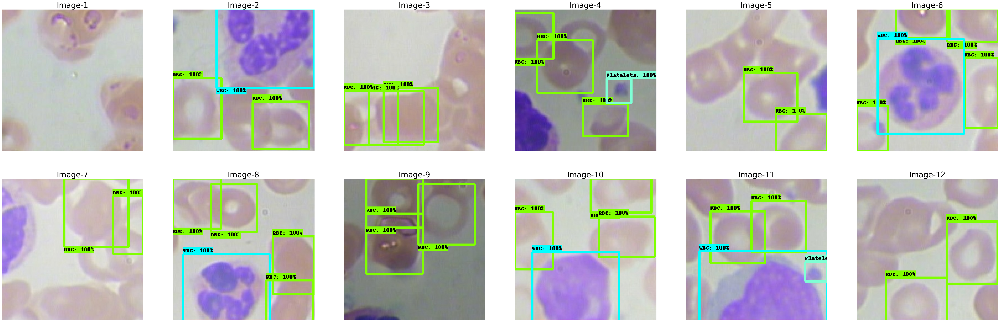

In [ ]:
buffer_size = 20
num_of_examples = 12

raw_records = tf.data.TFRecordDataset(
    exp_config.task.train_data.input_path).shuffle(
        buffer_size=buffer_size).take(num_of_examples)
show_batch(raw_records, num_of_examples)

# 3 - Train and evaluate.

We follow the COCO challenge tradition to evaluate the accuracy of object detection based on mAP(mean Average Precision). Please check [here](https://cocodataset.org/#detection-eval) for detail explanation of how evaluation metrics for detection task is done.

**IoU**: is defined as the area of the intersection divided by the area of the union of a predicted bounding box and ground truth bounding box.


## 3.1 - Run training and evaluation

In [ ]:

model, eval_logs = tfm.core.train_lib.run_experiment(
    distribution_strategy=distribution_strategy,
    task=task,
    mode='train_and_eval',
    params=exp_config,
    model_dir=model_dir,
    run_post_eval=True)


Streaming output truncated to the last 5000 lines.
     'ARmax1': 0.29276904,
     'ARmax10': 0.49844897,
     'ARmax100': 0.51254654,
     'ARs': 0.2,
     'best_APm': 0.26515594,
     'box_loss': 0.0050179963,
     'cls_loss': 0.34947214,
     'model_loss': 0.6003719,
     'steps_per_second': 4.319399066636659,
     'total_loss': 0.93193674,
     'validation_loss': 0.93193674}
train | step:    300 | training until step 400...
train | step:    400 | steps/sec:    2.8 | output: 
    {'box_loss': 0.0048380657,
     'cls_loss': 0.3439139,
     'learning_rate': 0.09960574,
     'model_loss': 0.5858171,
     'total_loss': 0.91578186,
     'training_loss': 0.91578186}
saved checkpoint to retinanet_resnetfpn_coco/trained_model/ckpt-400.
 eval | step:    400 | running 100 steps of evaluation...
creating index...
index created!
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=4.19s).
Accumulating evaluation results...
DONE (t=0.32s).
 Ave

## 3.2 - Load logs in tensorboard.

In [ ]:
# use load_ext for 1st load, reload_ext for every update
%load_ext tensorboard
%tensorboard --logdir {model_dir}

<IPython.core.display.Javascript object>

## 3.3 - Saving and exporting the trained model.

The `keras.Model` object returned by `train_lib.run_experiment` expects the data to be normalized by the dataset loader using the same mean and variance statiscics in `preprocess_ops.normalize_image(image, offset=MEAN_RGB, scale=STDDEV_RGB)`. This export function handles those details, so you can pass `tf.uint8` images and get the correct results.

In [ ]:
# use checkpoint_path = tf.train.latest_checkpoint(model_dir) for latest checkpoint
best_ckpt_path = '/content/Blood-Cells-Detection/retinanet_resnetfpn_coco/trained_model/best_checkpoints'

export_saved_model_lib.export_inference_graph(
    input_type='image_tensor',
    batch_size=1,
    input_image_size=[HEIGHT, WIDTH],
    params=exp_config,
    checkpoint_path= best_ckpt_path,
    export_dir=export_dir)

In [ ]:
# connect to google drive
from google.colab import drive
drive.mount('/content/drive')

In [ ]:
# save a copy of checkpoints
!zip -r /content/best_ckpt.zip /content/Blood-Cells-Detection/retinanet_resnetfpn_coco
shutil.copy('/content/ckpt.zip', '/content/drive/MyDrive/1.Projects/BloodImage')

# 4 - Inference from trained model

In [ ]:
def build_inputs_for_object_detection(image, input_image_size):
  """Builds Object Detection model inputs for serving."""
  image, _ = resize_and_crop_image(
      image,
      input_image_size,
      padded_size=input_image_size,
      aug_scale_min=1.0,
      aug_scale_max=1.0)
  return image

### 4.1 - Visualize test data

In [ ]:
# show some images from test set with their ground truth boxes
num_of_examples = 72 # Change this to see more images (also for inference below)

test_ds = tf.data.TFRecordDataset(
    './augmented_data/bccd_coco_tfrecords/test-00000-of-00001.tfrecord').take(
        num_of_examples)
show_batch(test_ds, num_of_examples)

## 4.2 - Importing SavedModel

In [ ]:
# import pretrained model
imported = tf.saved_model.load(export_dir)

# retrieve the inference function from the loaded SavedModel
model_fn = imported.signatures['serving_default']

## 4.3 - Visualize predictions

In [ ]:
# some hyperparameters
number_of_images = 72  # Change this to see more images
cols = 6
rows = number_of_images // cols + 1
input_image_size = (HEIGHT, WIDTH)
fig_height = rows * 10 + (rows - 1) * 4
fig_width = cols * 10 + (cols - 1) * 4
plt.figure(figsize=(fig_width, fig_height))
min_score_thresh = 0.3  # Change minimum score for threshold

# visualize predictions
for i, serialized_example in enumerate(test_ds):
    plt.subplot(rows, cols, i + 1)
    decoded_tensors = tf_ex_decoder.decode(serialized_example)
    image = build_inputs_for_object_detection(decoded_tensors['image'], input_image_size)
    image = tf.expand_dims(image, axis=0)
    image = tf.cast(image, dtype=tf.uint8)
    image_np = image[0].numpy()
    # predictions
    result = model_fn(image)

    # Get detections and scores
    boxes = result['detection_boxes'][0].numpy()
    classes = result['detection_classes'][0].numpy().astype(int)
    scores = result['detection_scores'][0].numpy()

    # Filter detections based on score threshold
    filtered_boxes = boxes[scores >= min_score_thresh]
    filtered_classes = classes[scores >= min_score_thresh]

    # Count detections by category
    category_counts = {}
    for category in filtered_classes:
        if category not in category_counts:
            category_counts[category] = 0
        category_counts[category] += 1

    # Generate count text based on category_index
    count_text = ""
    for category, count in category_counts.items():
        label = category_index[category]['name']
        count_text += f"{label}: {count}, "

    # Truncate trailing comma and space
    count_text = count_text[:-2]

    # Visualize predictions
    visualization_utils.visualize_boxes_and_labels_on_image_array(
        image_np,
        filtered_boxes,
        filtered_classes,
        scores,
        category_index=category_index,
        use_normalized_coordinates=False,
        max_boxes_to_draw=200,
        min_score_thresh=min_score_thresh,
        agnostic_mode=False,
        instance_masks=None,
        line_thickness=4
    )

    # Display image and count text
    plt.imshow(image_np)
    plt.title(f'Image-{i+1}. {count_text}', fontsize=30)
    plt.axis('off')

plt.show()
